In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
! pip install tensorflow==2.2.0

In [ ]:
!pip install  keras==2.3.1

In [2]:
### Importing the required libraries

import os
import warnings
warnings.filterwarnings('ignore')

os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'

import pandas as pd
import numpy as np
import tensorflow as tf
from tensorflow.keras import backend as K
from tensorflow import keras
from tensorflow.keras.layers import concatenate
import cv2
from google.colab.patches import cv2_imshow
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.layers import Input,Conv2D,Conv1D,MaxPool2D,Activation,AveragePooling2D,BatchNormalization,MaxPooling2D
from tensorflow.keras.layers import Multiply,Add
from tensorflow.keras.layers import UpSampling2D
os.environ['TF_FORCE_GPU_ALLOW_GROWTH'] = 'true'


from sklearn.model_selection import train_test_split
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score,mean_absolute_error

import datetime


In [ ]:
### Importing and unzipping the data from Gdrive
!unzip '/content/drive/MyDrive/NJU2K.zip' -d '/content/NJU2K'

In [4]:
### Creating the DataFrame with the paths of RGB,Depth and GT images

def return_images_df(path):
    # writing  the code that will create a dataframe with two columns ['RGB', 'Depth','GT']
    # the column 'RGB' will have path to RGB images
    # the column 'Depth' will have path to Depth images
    # The column 'GT' will have path to Ground Truth images
    RGB_images=[]
    Depth_images=[]
    GT_images=[]
    for i in os.listdir(path):
      if i=='GT-1985':
        for j in sorted(os.listdir(os.path.join(path,i))):
          GT_images.append(os.path.join(os.path.join(path,i),j))
    
      if i=='RGB_left':
        for j in sorted(os.listdir(os.path.join(path,i))):
          RGB_images.append(os.path.join(os.path.join(path,i),j))

      if i=='depth':
        for j in sorted(os.listdir(os.path.join(path,i))):
          Depth_images.append(os.path.join(os.path.join(path,i),j))
    
    dict={'RGB':RGB_images,'Depth':Depth_images,'GT':GT_images}
    
    data_df=pd.DataFrame(dict)

    return data_df

In [5]:
## Creating the DataFrame
root_dir='/content/NJU2K/NJU2K'
data_df = return_images_df(root_dir)
print(data_df.shape)
data_df.head()

(1985, 3)


,RGB,Depth,GT
0,/content/NJU2K/NJU2K/RGB_left/000001_left.jpg,/content/NJU2K/NJU2K/depth/000001_left.png,/content/NJU2K/NJU2K/GT-1985/000001_left.png
1,/content/NJU2K/NJU2K/RGB_left/000002_left.jpg,/content/NJU2K/NJU2K/depth/000002_left.png,/content/NJU2K/NJU2K/GT-1985/000002_left.png
2,/content/NJU2K/NJU2K/RGB_left/000003_left.jpg,/content/NJU2K/NJU2K/depth/000003_left.png,/content/NJU2K/NJU2K/GT-1985/000003_left.png
3,/content/NJU2K/NJU2K/RGB_left/000004_left.jpg,/content/NJU2K/NJU2K/depth/000004_left.png,/content/NJU2K/NJU2K/GT-1985/000004_left.png
4,/content/NJU2K/NJU2K/RGB_left/000005_left.jpg,/content/NJU2K/NJU2K/depth/000005_left.png,/content/NJU2K/NJU2K/GT-1985/000005_left.png


In [6]:
### Creating the Dataloader 

class Dataset:
   
    def __init__(self, data,w=160,h=160):
        
      
        self.ids = data
        
        self.RGB_images   = [RGB[0] for RGB in self.ids]                        # the paths of RGB images
        
        self.Depth_images    = [Depth[1] for Depth in self.ids]                 # the paths of Depth images
        
        self.GT_images    = [GT[2] for GT in self.ids]                          # the paths of Ground Truth images

        self.class_values=[0,255]                                               ## Creating the two different channels for two classes i.e binary classes

        self.w = w
        self.h = h                                                            ## Resizing the image 
    
    def __getitem__(self, i):
        
        # read data
        
        RGB_image = cv2.imread(self.RGB_images[i], cv2.IMREAD_UNCHANGED)

        RGB_image =cv2.resize(RGB_image,(self.w,self.h),interpolation=cv2.INTER_AREA)   ## Loading the RGB image and resizing it to required size
        
        RGB_image=RGB_image/255

        Depth_image = cv2.imread(self.Depth_images[i]) 

        Depth_image =cv2.resize(Depth_image,(self.w,self.h),interpolation=cv2.INTER_AREA)  ## Loading the Depth image and resizing it to required size
       
        Depth_image=Depth_image/255
       

        GT_image = cv2.imread(self.GT_images[i],0) 

        GT_image_init =cv2.resize(GT_image,(self.w,self.h),interpolation=cv2.INTER_AREA)    ## Loading the Ground Truth image and resizing it to required size

        GT_images=[np.where((GT_image_init == v),1,0).astype('float32') for v in self.class_values]   ## Creating two channels for two classes

        GT_image=np.stack(GT_images, axis=-1).astype('float')                                       ### Stacking these channels
      
        
        GT_image_global=MaxPool2D(pool_size=(8,8),strides=(8,8))(np.expand_dims(GT_image_init,axis=(0,3)))   ## Downsizing the Ground truth image for Coarse predicction comparision
      
        GT_image_global=np.reshape(GT_image_global,(20,20))                     ### Reshaping the image to required size

        GT_image_globals=[np.where((GT_image_global == v),1,0).astype('float32') for v in self.class_values]   ## Creating two channels for two classes

        GT_image_global=np.stack(GT_image_globals, axis=-1).astype('float')           ### Stacking these channels
 

        return RGB_image,Depth_image,GT_image,GT_image_global           ## Returning the images
        
    def __len__(self):
        return len(self.ids)
    
    
class Dataloder(tf.keras.utils.Sequence):       ## Dataloader for train and test dataset
    def __init__(self, dataset, batch_size=1, shuffle=False):
        self.dataset = dataset
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.indexes = np.arange(len(dataset))

    def __getitem__(self, i):
        
        # collect batch data
        start = i * self.batch_size
        stop = (i + 1) * self.batch_size
 
        data = []
        for j in range(start, stop):
            data.append(self.dataset[j])

        batch = [np.stack(samples,axis=0) for samples in zip(*data)]   ## Stacking the samples according to the batch size

        batch=[[batch[0],batch[1]],[batch[3],batch[3],batch[2]]]    ### Creating the data into required format i.e [[x,x],[y,y,y]]
    
        
        return tuple(batch)   ## returning the Data samples
    
    def __len__(self):
        return len(self.indexes) // self.batch_size
    
    def on_epoch_end(self):
        if self.shuffle:
            self.indexes = np.random.permutation(self.indexes)  ## Doing the shuffling after every epoch

In [7]:
### Splitting the Dataset into Train and test
X_train, X_test = train_test_split(data_df, test_size=0.20, random_state=42)

In [8]:
train_dataset = Dataset(X_train.values)
test_dataset=Dataset(X_test.values)

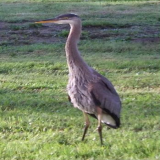

In [ ]:
cv2_imshow(train_dataset[10][0]*255)

In [ ]:
cv2_imshow(np.argmax(train_dataset[10][3],axis=-1)*255)

In [9]:
## Intializing the Dataloders

train_dataloader=Dataloder(train_dataset)
test_dataloader=Dataloder(test_dataset)

BUILDING THE MODEL ARCHITECTURE:

Creating the backbone network using the Resnet101 network without fully connected layers:


In [10]:
def identity_block(input_tensor, kernel_size, filters, stage, block):
  ### Code is taken from https://gist.github.com/flyyufelix/65018873f8cb2bbe95f429c474aa1294 here and modified according to our needs
    '''The identity_block is the block that has no conv layer at shortcut
    # Arguments
        input_tensor: input tensor
        kernel_size: defualt 3, the kernel size of middle conv layer at main path
        filters: list of integers, the nb_filters of 3 conv layer at main path
        stage: integer, current stage label, used for generating layer names
        block: 'a','b'..., current block label, used for generating layer names
    '''
 
    nb_filter1, nb_filter2, nb_filter3 = filters
    conv_name_base = 'res' + str(stage) + block + '_branch'
    bn_name_base = 'bn' + str(stage) + block + '_branch'
    scale_name_base = 'scale' + str(stage) + block + '_branch'

    x = Conv2D(nb_filter1, 1, padding='same', name=conv_name_base + '2a',kernel_initializer='glorot_uniform')(input_tensor)
    x = BatchNormalization( epsilon=eps,axis=bn_axis, name=bn_name_base + '2a')(x)
    
    x = Activation('relu', name=conv_name_base + '2a_relu')(x)


    x = Conv2D(nb_filter2,kernel_size, padding='same', name=conv_name_base + '2b',kernel_initializer='glorot_uniform')(x)
    x = BatchNormalization(epsilon=eps, axis=bn_axis, name=bn_name_base + '2b')(x)
    
    x = Activation('relu', name=conv_name_base + '2b_relu')(x)

    x = Conv2D(nb_filter3,  1, padding='same',name=conv_name_base + '2c',kernel_initializer='glorot_uniform')(x)
    x = BatchNormalization( epsilon=eps,axis=bn_axis, name=bn_name_base + '2c')(x)

    x = Add(name='res' + str(stage) + block)([x, input_tensor])
    x = Activation('relu', name='res' + str(stage) + block + '_relu')(x)
    return x


In [11]:
def conv_block(input_tensor, kernel_size, filters, stage, block, strides=(2, 2)):
   ### Code is taken from https://gist.github.com/flyyufelix/65018873f8cb2bbe95f429c474aa1294 here and modified according to our needs
    '''conv_block is the block that has a conv layer at shortcut
    # Arguments
        input_tensor: input tensor
        kernel_size: defualt 3, the kernel size of middle conv layer at main path
        filters: list of integers, the nb_filters of 3 conv layer at main path
        stage: integer, current stage label, used for generating layer names
        block: 'a','b'..., current block label, used for generating layer names
    Note that from stage 3, the first conv layer at main path is with subsample=(2,2)
    And the shortcut should have subsample=(2,2) as well
    '''
   
    nb_filter1, nb_filter2, nb_filter3 = filters
    conv_name_base = 'res' + str(stage) + block + '_branch'
    bn_name_base = 'bn' + str(stage) + block + '_branch'
    scale_name_base = 'scale' + str(stage) + block + '_branch'

    x = Conv2D(nb_filter1, 1,  strides=strides,name=conv_name_base + '2a',kernel_initializer='glorot_uniform')(input_tensor)
    x = BatchNormalization(epsilon=eps, axis=bn_axis, name=bn_name_base + '2a')(x)
   
    x = Activation('relu', name=conv_name_base + '2a_relu')(x)

    x = Conv2D(nb_filter2, kernel_size, name=conv_name_base + '2b', padding='same',kernel_initializer='glorot_uniform')(x)
    x = BatchNormalization( epsilon=eps,axis=bn_axis, name=bn_name_base + '2b')(x)
    
    x = Activation('relu', name=conv_name_base + '2b_relu')(x)

    x = Conv2D(nb_filter3, 1, name=conv_name_base + '2c',padding='same',kernel_initializer='glorot_uniform')(x)
    x = BatchNormalization( epsilon=eps,axis=bn_axis, name=bn_name_base + '2c')(x)


    shortcut = Conv2D(nb_filter3, 1,  strides=strides, name=conv_name_base + '1',kernel_initializer='glorot_uniform' )(input_tensor)
    shortcut = BatchNormalization(epsilon=eps, axis=bn_axis, name=bn_name_base + '1')(shortcut)
    

    x = Add(name='res' + str(stage) + block)([x, shortcut])
    x = Activation('relu', name='res' + str(stage) + block + '_relu')(x)
    return x

Building the side paths:

We have total 6 no of side paths in the network which are connected to 

side_path1 to conv1_2

side_path2 to conv2_2

side_path3 to conv3_3

side_path4 to conv4_3

side_path5 to conv5_3

side_path6 to pool5  of the vgg network these side path specifications are given below:

kernel_size,filters,stride,dialation_rate,padding

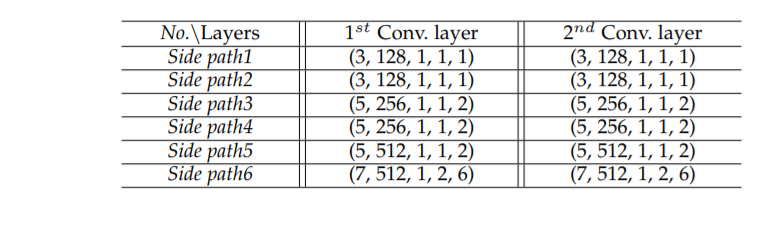

In [12]:
## Writing the conv layer class for Side paths
## Since all the sidepaths are CNN layers with different filters we are creating this class object 

class side_path(tf.keras.layers.Layer):
    def __init__(self, kernel=3,  filters=128, strides=1,name="side_path"):
        super().__init__(name=name)
        self.F = filters
        self.k = kernel
        self.strides = strides
        
    def call(self, X):
        
        #### Writing the conv2D layers

        conv_1=Conv2D(self.F,self.k,padding='same', strides=self.strides,activation='relu',kernel_initializer='glorot_uniform')(X)
        conv_2=Conv2D(self.F,self.k,padding='same',strides=self.strides, activation='relu',kernel_initializer='glorot_uniform')(conv_1)
        conv_3=Conv2D(self.F,self.k,padding='same',strides=self.strides, activation='relu',kernel_initializer='glorot_uniform')(conv_2)
        return conv_3

Building the Cross-model fusion module:

The output from side paths fed to the Feature Compression module CP here the no of channels reduce to the k no i.e 64 in this case. The output from the CP module still has batch structure. Here in the CM module, initially we will split the batch and then conduct the element wise Addition and multiplication operations. Output from the CM module having the k channels

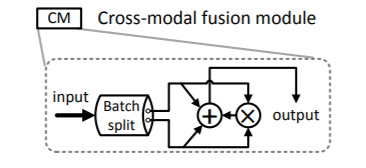

In [13]:
## Creating the Cross‐modal fusion module

class CM_module(tf.keras.layers.Layer):
    def __init__(self,name="CM_module"):
        super().__init__(name=name)
       
    def call(self, X):

        RGB_batch,Depth_batch=tf.split(X,num_or_size_splits=2,axis=0)   ### Splitting the batch into two seperate batches
        Add1=Add()([RGB_batch,Depth_batch])                              
        mult1=Multiply()([RGB_batch,Depth_batch])                       ### Conducting the Addition and multiplication operations
        Add2=Add()([Add1,mult1])
        Add2=Conv2D(64,3,padding='same',activation='relu',kernel_initializer='glorot_uniform')(Add2)
        return Add2



Building the Feature Aggregation module:

Here, we Add the outputs from CM5 and CM6 and then pass this to FA5 module.later we will do upsampling of FA5 output and then add with CM4 output and then pass to FA4  like this we will do upto FA1 module. The output from FA1 pass to conv layer and compare this with the ground truth.

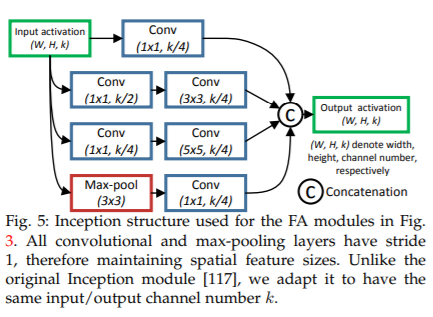


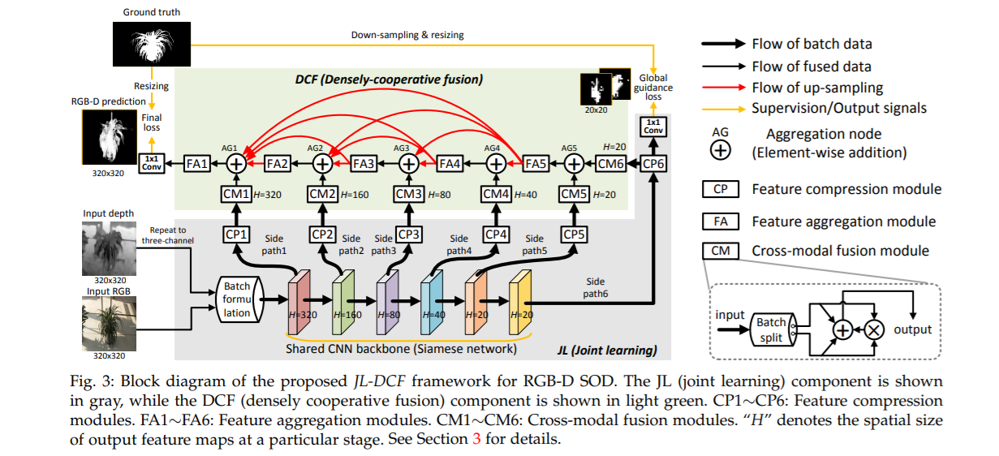

In [14]:
#### Creating the feature Aggretion module

class FA_module(tf.keras.layers.Layer):
    def __init__(self,kernel=[1,3,5],  filters=[16,32], strides=1,name="FA_module"):
        super().__init__(name=name)
        self.F1,self.F2 = filters
        self.k1,self.k2,self.k3 = kernel
        self.strides = strides

    def call(self, X):
        
        #### Writing the conv2D layers

        conv_1=Conv2D(self.F1,self.k1,padding='same', strides=self.strides,activation='relu',kernel_initializer='glorot_uniform')(X)

        conv_2_1=Conv2D(self.F2,self.k1,padding='same',strides=self.strides, activation='relu',kernel_initializer='glorot_uniform')(X)
        conv_2_2=Conv2D(self.F1,self.k2,padding='same',strides=self.strides,activation='relu',kernel_initializer='glorot_uniform')(conv_2_1)

        conv_3_1=Conv2D(self.F1,self.k1,padding='same',strides=self.strides,activation='relu',kernel_initializer='glorot_uniform')(X)
        conv_3_2=Conv2D(self.F1,self.k3,padding='same',strides=self.strides,activation='relu',kernel_initializer='glorot_uniform')(conv_3_1)

        pool_4=MaxPool2D(pool_size=(3,3),strides=1,padding='same')(X)
        conv_4=Conv2D(self.F1,self.k1,padding='same',strides=self.strides,activation='relu',kernel_initializer='glorot_uniform')(pool_4)
        

        FA=concatenate([conv_1,conv_2_2,conv_3_2,conv_4],axis=-1)  ## Concatenating the all outputs fron all the layers
        FA=Conv2D(64,3,padding='same',strides=self.strides,activation='relu',kernel_initializer='glorot_uniform')(FA)
        FA=tf.keras.layers.Dropout(0.4)(FA)
        return FA

In [15]:
tf.keras.backend.clear_session()

In [16]:
eps = 1.1e-5   

bn_axis = 3
   

RGB_input=Input(shape=(160,160,3), batch_size=1,name='RGB_image')          ### Two different inputs of RGB and Depth images
Depth_input=Input(shape=(160,160,3), batch_size=1,name='Depth_image')

input=tf.stack([RGB_input,Depth_input],axis=0)
input=tf.reshape(input,[2,160,160,3])                     ### Adding in batch direction

#### Building Resnet Network

conv1_1=Conv2D(64,3,padding='same',strides=1, activation='relu',kernel_initializer='glorot_uniform')(input)
conv1_2=Conv2D(64,3,padding='same', strides=1,activation='relu',kernel_initializer='glorot_uniform')(conv1_1)

x = Conv2D(64, 6,strides=1, name='conv1',padding='same',kernel_initializer='glorot_uniform' )(conv1_2)
x = BatchNormalization( epsilon=eps,axis=bn_axis, name='bn_conv1')(x)

x = Activation('relu', name='conv1_relu')(x)
conv_1 = MaxPooling2D((2, 2), strides=(2, 2), name='pool1')(x)

x = conv_block(conv_1, 3, [64, 64, 256], stage=2, block='a', strides=(2, 2))
x = identity_block(x, 3, [64, 64, 256], stage=2, block='b')
res2c = identity_block(x, 3, [64, 64, 256], stage=2, block='c')

res3b3 = conv_block(res2c, 3, [128, 128, 512], stage=3, block='a')
for i in range(1,3):
  res3b3 = identity_block(res3b3, 3, [128, 128, 512], stage=3, block='b'+str(i))

res4b22 = conv_block(res3b3, 3, [256, 256, 1024], stage=4, block='a')
for i in range(1,23):
  res4b22 = identity_block(res4b22, 3, [256, 256, 1024], stage=4, block='b'+str(i))

x = conv_block(res4b22, 3, [512, 512, 2048], stage=5, block='a',strides=(1,1))
x = identity_block(x, 3, [512, 512, 2048], stage=5, block='b')
res5c = identity_block(x, 3, [512, 512, 2048], stage=5, block='c')


### Connecting the resnet with side paths

side_path_1=side_path().call(conv1_2)

side_path_2=side_path().call(conv_1)

side_path_3=side_path(kernel=5,filters=256).call(res2c)

side_path_4=side_path(kernel=5,filters=256).call(res3b3)

side_path_5=side_path(kernel=5,filters=512).call(res4b22)

side_path_6_1=Conv2D(512,7,strides=1,dilation_rate=2,padding='same',activation='relu',kernel_initializer='glorot_uniform')(res5c)
side_path_6=Conv2D(512,7,strides=1,dilation_rate=2,padding='same',activation='relu',kernel_initializer='glorot_uniform')(side_path_6_1)
side_path_6=Conv2D(512,7,strides=1,dilation_rate=2,padding='same',activation='relu',kernel_initializer='glorot_uniform')(side_path_6)

### Connecting the side_paths to Feature Compression modules (CP)

cp_1=Conv2D(64,3,padding='same',activation='relu',kernel_initializer='glorot_uniform')(side_path_1)  ## Passing the output of side path to CP module

cp_2=Conv2D(64,3,padding='same',activation='relu',kernel_initializer='glorot_uniform')(side_path_2)

cp_3=Conv2D(64,3,padding='same',activation='relu',kernel_initializer='glorot_uniform')(side_path_3)

cp_4=Conv2D(64,3,padding='same',activation='relu',kernel_initializer='glorot_uniform')(side_path_4)

cp_5=Conv2D(64,3,padding='same',activation='relu',kernel_initializer='glorot_uniform')(side_path_5)

cp_6=Conv2D(64,3,padding='same',activation='relu',kernel_initializer='glorot_uniform')(side_path_6)

cp_6_out=Conv2D(32,1,padding='same',activation='relu',kernel_initializer='glorot_uniform')(cp_6)
cp_6_out=Conv2D(8,1,padding='same',activation='relu',kernel_initializer='glorot_uniform')(cp_6_out)
cp_6_out=Conv2D(2,1,padding='same',activation='relu',kernel_initializer='glorot_uniform')(cp_6)

global_1,global_2=tf.split(cp_6_out,num_or_size_splits=2,axis=0)  ## Splitting the output of CP6 module into Depth and RGB outputs

### Connecting the CP modules to CM modules

cm1=CM_module().call(cp_1)           ### Passing the CP output to CM module

cm2=CM_module().call(cp_2)

cm3=CM_module().call(cp_3)

cm4=CM_module().call(cp_4)

cm5=CM_module().call(cp_5)

cm6=CM_module().call(cp_6)

### Adding the Feature Aggregation Modules FA

AG5=Add()([cm5,cm6])                                       ### Adding the outputs of CM5 and CM6 modules

FA5=FA_module().call(AG5)                                    ### Passing the Aggregation5 output to FA5 module

FA5_up_1=UpSampling2D((2,2),interpolation='bilinear')(FA5)   ### Upsampling the FA5 output

AG4=Add()([FA5_up_1,cm4])                                    ### Adding the upsampled output of FA modules to CM4 module output

FA4=FA_module().call(AG4)                                     ### Passing the Aggregation4 output to FA4 module

FA4_up_1=UpSampling2D((2,2),interpolation='bilinear')(FA4)   ### Upsampling the FA5 and FA4 output
FA5_up_2=UpSampling2D((4,4),interpolation='bilinear')(FA5)

AG3=Add()([FA4_up_1,FA5_up_2,cm3])                           ### Adding all the upsampled outputs of FA modules to CM3 module output

FA3=FA_module().call(AG3)                                     ### Passing the Aggregation3 output to FA3 module

FA3_up_1=UpSampling2D((2,2),interpolation='bilinear')(FA3)   ### Upsampling the FA5,FA4 and FA3 output
FA4_up_2=UpSampling2D((4,4),interpolation='bilinear')(FA4)
FA5_up_3=UpSampling2D((8,8),interpolation='bilinear')(FA5)

AG2=Add()([FA3_up_1,FA4_up_2,FA5_up_3,cm2])                     ### Adding all the upsampled outputs of FA modules to CM2 module output

FA2=FA_module().call(AG2)                                      ### Passing the Aggregation2 output to FA2 module

FA2_up_1=UpSampling2D((2,2),interpolation='bilinear')(FA2)    ### Upsampling the FA5,FA4,FA3 and FA2 output
FA3_up_2=UpSampling2D((4,4),interpolation='bilinear')(FA3)
FA4_up_3=UpSampling2D((8,8),interpolation='bilinear')(FA4)
FA5_up_4=UpSampling2D((16,16),interpolation='bilinear')(FA5)

AG1=Add()([FA2_up_1,FA3_up_2,FA4_up_3,FA5_up_4,cm1])          ### Adding all the upsampled outputs of FA modules to CM1 module output

FA1=FA_module().call(AG1)                                      ### Passing the Aggregation1 output to FA1 module

FA1_out=Conv2D(32,1,padding='same',activation='relu',kernel_initializer='glorot_uniform')(FA1)
FA1_out=Conv2D(8,1,padding='same',activation='relu',kernel_initializer='glorot_uniform')(FA1_out)                                                             ### Passing the output from FA1 module to Final Conv2D layer, here we are creating the 2 channels as the GT having 2 channels
Final_output=Conv2D(2,1,padding='same',name='Final_output',activation='softmax',kernel_initializer='glorot_uniform')(FA1)

global_RGB=UpSampling2D((2,2),interpolation='bilinear')(global_1)   ### Passing the output from CP6 module to Final Conv2D layer, here we are creating the 2 channels as the GT having 2 channels
global_RGB=Conv2D(2,1,activation='softmax',padding='same',name='RGB_coarse',kernel_initializer='glorot_uniform')(global_RGB)
global_Depth=UpSampling2D((2,2),interpolation='bilinear')(global_2)
global_Depth=Conv2D(2,1,activation='softmax',padding='same',name='Depth_coarse',kernel_initializer='glorot_uniform')(global_Depth)
                                                                   ### Passing the output from CP6 module to Final Conv2D layer, here we are creating the 2 channels as the GT having 2 channels
print(Final_output.shape)
print(global_Depth.shape)
print(global_RGB.shape)
      ## Intiating the Model with two inputs and three outputs
model=Model(inputs=[RGB_input,Depth_input],outputs=[global_RGB,global_Depth,Final_output])


model.summary()


tf.keras.utils.plot_model(
    model, to_file='model.png', show_shapes=True, show_layer_names=True,      ## Plotting the model
    rankdir='TB')

(1, 160, 160, 2)
(1, 20, 20, 2)
(1, 20, 20, 2)
Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
RGB_image (InputLayer)          [(1, 160, 160, 3)]   0                                            
__________________________________________________________________________________________________
Depth_image (InputLayer)        [(1, 160, 160, 3)]   0                                            
__________________________________________________________________________________________________
tf.stack (TFOpLambda)           (2, 1, 160, 160, 3)  0           RGB_image[0][0]                  
                                                                 Depth_image[0][0]                
__________________________________________________________________________________________________
tf.reshape (TFOpLambda)         (2, 160, 160, 3

In [18]:
### This code was taken from this link https://github.com/tensorflow/tensorflow/issues/37876#issuecomment-760064536
## It avoids the call backs are slow than batch updates type warnings

from tensorflow.keras.callbacks import CallbackList
class CustomCallbackList(CallbackList):
    def _call_batch_hook(self, mode, hook, batch, logs=None):
        """Helper function for all batch_{begin | end} methods."""
        if not self.callbacks:
            return
        hook_name = 'on_{mode}_batch_{hook}'.format(mode=mode, hook=hook)

        logs = logs or {}
        for callback in self.callbacks:
            batch_hook = getattr(callback, hook_name)
            batch_hook(batch, logs)

tf.keras.callbacks.CallbackList = CustomCallbackList


In [19]:
### Here, we are dividing the image into blocks for S_score calculation

def divide_image(image):
    
    length=image.shape[0]
    L=int(length/2)
    h1=image[:L]         ### Diving the image into two parts
    h2=image[L:]

    image1=[]
    image2=[]
    image3=[]
    image4=[]
    length2=len(h1[0])
    L=int(length2/2)
    for i in range(L):      ## Dividing the above two images into two another parts
      w1=h1[i][:L]
      w2=h1[i][L:]
      w3=h2[i][:L]
      w4=h2[i][L:]

      image1.append(w1)
      image2.append(w2)
      image3.append(w3)
      image4.append(w4)

    return np.array(image1),np.array(image2),np.array(image3),np.array(image4)

In [20]:
## Calculating the S_score https://openaccess.thecvf.com/content_ICCV_2017/papers/Fan_Structure-Measure_A_New_ICCV_2017_paper.pdf

def S_score(actual_image,pred_image,pred_image_,actual_image_):
    
    w=actual_image.shape[1]
    h=actual_image.shape[2]

    images_4_gt=[i for i in divide_image(np.reshape(actual_image,(w,h)))]
    images_4_pred=[i for i in divide_image(np.reshape(pred_image,(w,h)))]
    
    W=np.sum(np.reshape(actual_image,(w,h)))
    
    ssim=[]

    for i in range(len(images_4_gt)):

      images_gt=divide_image(images_4_gt[i])     ## Here we divide the whole image into 16 parts

      images_pred=divide_image(images_4_pred[i])
  
      for j in range(len(images_gt)):
        ### Calculating the luminance comparision of image (2*x*y/x**2+y**2) here x and y are the means of predicted and ground truth images

        ssm=(2*np.mean(images_gt[j])*np.mean(images_pred[j]))/((np.mean(images_gt[j]))**2+(np.mean(images_pred[j]))**2+0.0001)
      
        ### Calculating the contrast comparision of image (2*x*y/x**2+y**2) here x and y are the variance of predicted and ground truth images

        ssd=(2*np.std(images_gt[j])*np.std(images_pred[j]))/((np.std(images_gt[j]))**2+(np.std(images_pred[j]))**2+0.0001)
      
        ### Calculating the structure comparision of image (c/x**2+y**2) here x and y are the variance of predicted and ground truth images and c is the covariance of the two images
        ssc=np.sum(((images_gt[j]-np.mean(images_gt[j]))*(images_pred[j]-np.mean(images_pred[j])))/((np.std(images_gt[j]))*(np.std(images_pred[j]))+0.0001))/(40*40-1)
      
        w_k=(np.sum(images_gt[j]))/W   ## Calculating the weights
        
        ssir=w_k*ssm*ssd*ssc  ###  calculating the region-aware structural similarity measure 
        
        ssim.append(ssir)
        
    S_r=sum(ssim)   ### calculating the region-aware structural similarity measure 

    ### calculating the object-aware structural similarity measure 
    pred_image_reshape=np.reshape(pred_image_,(w,h,2))

    pred_image_FG=pred_image_reshape[:,:,0]  ## Dividing the predicted  image into foreground and background images

    pred_image_BG=pred_image_reshape[:,:,1]

    OFG=(2*np.mean(pred_image_FG))/((np.mean(pred_image_FG))**2+1+2*0.25*np.std(pred_image_FG))  ## Calculating the similarity at object levels
  
    BFG=(2*np.mean(pred_image_BG))/((np.mean(pred_image_BG))**2+1+2*0.25*np.std(pred_image_BG))
    
    actual_image_=np.reshape(actual_image_,(w,h,2))

    m_u=np.mean(actual_image_[:,:,1])

    S_o=m_u*OFG+(1-m_u)*BFG

    S_score=S_r*0.5+S_o*0.5   ## Calculating the S_score

    return S_score

In [21]:
### Calculating the E_score  https://www.ijcai.org/proceedings/2018/0097.pdf

def E_score(actual_image,pred_image):

    w=actual_image.shape[1]
    h=actual_image.shape[2]
    
    pred_image=np.reshape(pred_image,(w,h))

    actual_image=np.reshape(actual_image,(w,h))

    bias_pred=pred_image-np.ones((w,h))*np.mean(pred_image)  ### Calculating the bias matrix of predicted image

    bias_gt=actual_image-np.ones((w,h))*np.mean(actual_image)   ### Calculating the bias matrix of ground truth image

    FM=(2*bias_pred*bias_gt)/((bias_gt*bias_gt)+(bias_pred*bias_pred))  ### Calculating the alighnment matrix of ground truth image

    f=((1+FM)**2)/(4)  ## Calculating the enhanced alignment matrix 

    E=np.sum(f)/(w*h)    ### Calculating the E_score
    
    return E

In [22]:
## Calculating the Metrics

class Loss_History(tf.keras.callbacks.Callback):
  def __init__(self,validation_data=test_dataloader):
    super(Loss_History,self).__init__()
    self.validation_data=validation_data
    self.history={'precision':[],'recall':[],'F_beta_score':[],'S_score':[],'E_score':[],'MAE':[]}
  
  
  def on_test_batch_end(self,batch,logs={}):

    r,d,pred_image_=self.model.predict(test_dataloader[batch][0])  ## Predicting the final output image

    pred_image=np.argmax(pred_image_,axis=-1)    ## Sorting the channel wise of image

    actual_image_=test_dataloader[batch][1][2]  ## Ground truth

    actual_image=np.argmax(actual_image_,axis=-1)
   
    w=actual_image.shape[1]
    h=actual_image.shape[2]

    precision=precision_score(np.reshape(actual_image,(w,h)),np.reshape(pred_image,(w,h)),average='micro')  ## Finding the precision and recall

    recall=recall_score(np.reshape(actual_image,(w,h)),np.reshape(pred_image,(w,h)),average='micro')

    mae=mean_absolute_error(np.reshape(actual_image,(w,h)),np.reshape(pred_image,(w,h)))      ## Finding the mean absolute error

    F_b_score=(1.3*precision*recall)/(0.3*precision+recall+0.00001)    ## Finding the F_beta_score

    s_score=S_score(actual_image,pred_image,pred_image_,actual_image_)  ## Finding the S_score and E_score
    
    e_score=E_score(actual_image,pred_image)

    self.history['precision'].append(precision)

    self.history['recall'].append(recall)

    self.history['F_beta_score'].append(F_b_score)

    self.history['S_score'].append(s_score)

    self.history['E_score'].append(e_score)

    self.history['MAE'].append(mae)
    
  def on_epoch_end(self,epoch,logs={}):
    
    
    precision_score=np.mean(np.array(self.history['precision']))

    recall_score=np.mean(np.array(self.history['recall']))

    F_score=np.mean(np.array(self.history['F_beta_score']))

    s_score=np.mean(np.array(self.history['S_score']))
    
    e_score=np.mean(np.array(self.history['E_score']))

    mae_score=np.mean(np.array(self.history['MAE']))

    print('precision_score:%f,recall_score:%f,F_beta_score:%f,S_score:%f,E_score:%f,MAE:%f'%(precision_score,recall_score,F_score,s_score,e_score,mae_score))


    return

history_own=Loss_History()


In [23]:
%load_ext tensorboard

In [ ]:
### Compiling the model

model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),  ## optimizer,lr and momentum values taken as suggested in paper
    loss={ 'RGB_coarse':tf.keras.losses.BinaryCrossentropy(),  ## As we converted all the images to binary we are using the binary cross entropy
          'Depth_coarse':tf.keras.losses.BinaryCrossentropy(),  ## These two are for coarse outputs of VGG16
          "Final_output":tf.keras.losses.BinaryCrossentropy()  ## This loss we obtained at final output
         } )

In [ ]:
log_dir="/content/drive/MyDrive/best_model_CS2_resnet/logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")

tensor_board = tf.keras.callbacks.TensorBoard(log_dir=log_dir, write_graph=True)

lr_plateu=tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=2, mode='min', min_delta=0.001,  min_lr=0)
early_stop=tf.keras.callbacks.EarlyStopping(monitor='val_loss', min_delta=0.001, patience=5, mode='min',restore_best_weights=True)

checkpoint = tf.keras.callbacks.ModelCheckpoint('/content/drive/MyDrive/best_model_CS2_resnet.h5', save_weights_only=False, save_best_only=True, mode='min', monitor='val_loss')

In [ ]:
history=model.fit(train_dataloader,validation_data=test_dataloader,epochs=35,callbacks=[checkpoint,history_own,lr_plateu,tensor_board,early_stop],workers=-1)  ## Fitting the model with the call backs and epochs

Epoch 1/35
1588/1588 [==============================] - 803s 505ms/step - loss: 1.4316 - RGB_coarse_loss: 0.5092 - Depth_coarse_loss: 0.5090 - Final_output_loss: 0.4135 - val_loss: 1.7460 - val_RGB_coarse_loss: 0.6324 - val_Depth_coarse_loss: 0.5649 - val_Final_output_loss: 0.5487 - lr: 1.0000e-04
Epoch 2/35
1588/1588 [==============================] - 831s 523ms/step - loss: 1.3160 - RGB_coarse_loss: 0.4945 - Depth_coarse_loss: 0.4775 - Final_output_loss: 0.3441 - val_loss: 1.4369 - val_RGB_coarse_loss: 0.5335 - val_Depth_coarse_loss: 0.5028 - val_Final_output_loss: 0.4006 - lr: 1.0000e-04
Epoch 3/35
1588/1588 [==============================] - 830s 522ms/step - loss: 1.2487 - RGB_coarse_loss: 0.4857 - Depth_coarse_loss: 0.4496 - Final_output_loss: 0.3134 - val_loss: 1.3805 - val_RGB_coarse_loss: 0.5288 - val_Depth_coarse_loss: 0.4786 - val_Final_output_loss: 0.3731 - lr: 1.0000e-04
Epoch 4/35
1588/1588 [==============================] - 831s 523ms/step - loss: 1.1724 - RGB_coarse_los

In [ ]:
history=model.fit(train_dataloader,validation_data=test_dataloader,epochs=35,initial_epoch=15,callbacks=[checkpoint,history_own,lr_plateu,tensor_board,early_stop],workers=-1)  ## Fitting the model with the call backs and epochs

Epoch 16/35
1588/1588 [==============================] - 763s 480ms/step - loss: 0.6770 - RGB_coarse_loss: 0.3405 - Depth_coarse_loss: 0.2098 - Final_output_loss: 0.1268 - val_loss: 1.0358 - val_RGB_coarse_loss: 0.4664 - val_Depth_coarse_loss: 0.3366 - val_Final_output_loss: 0.2328 - lr: 1.0000e-07
Epoch 17/35
1588/1588 [==============================] - 819s 516ms/step - loss: 0.6755 - RGB_coarse_loss: 0.3398 - Depth_coarse_loss: 0.2093 - Final_output_loss: 0.1264 - val_loss: 1.0243 - val_RGB_coarse_loss: 0.4601 - val_Depth_coarse_loss: 0.3342 - val_Final_output_loss: 0.2301 - lr: 1.0000e-07
Epoch 18/35
1588/1588 [==============================] - 764s 481ms/step - loss: 0.6739 - RGB_coarse_loss: 0.3393 - Depth_coarse_loss: 0.2090 - Final_output_loss: 0.1256 - val_loss: 1.0393 - val_RGB_coarse_loss: 0.4677 - val_Depth_coarse_loss: 0.3360 - val_Final_output_loss: 0.2356 - lr: 1.0000e-07
Epoch 19/35
1588/1588 [==============================] - 762s 480ms/step - loss: 0.6729 - RGB_coarse

In [24]:
model=load_model('/content/drive/MyDrive/best_model_CS2_resnet.h5')

In [ ]:
history=model.fit(train_dataloader,validation_data=test_dataloader,epochs=35,initial_epoch=20,callbacks=[checkpoint,history_own,lr_plateu,tensor_board,early_stop],workers=-1)  ## Fitting the model with the call backs and epochs

Epoch 21/35
1588/1588 [==============================] - 1956s 1s/step - loss: 0.6741 - RGB_coarse_loss: 0.3393 - Depth_coarse_loss: 0.2090 - Final_output_loss: 0.1258 - val_loss: 1.0496 - val_RGB_coarse_loss: 0.4767 - val_Depth_coarse_loss: 0.3361 - val_Final_output_loss: 0.2368 - lr: 1.0000e-07
Epoch 22/35
1588/1588 [==============================] - 1974s 1s/step - loss: 0.6728 - RGB_coarse_loss: 0.3388 - Depth_coarse_loss: 0.2087 - Final_output_loss: 0.1254 - val_loss: 1.0329 - val_RGB_coarse_loss: 0.4625 - val_Depth_coarse_loss: 0.3355 - val_Final_output_loss: 0.2349 - lr: 1.0000e-07
Epoch 23/35
1588/1588 [==============================] - 1920s 1s/step - loss: 0.6719 - RGB_coarse_loss: 0.3384 - Depth_coarse_loss: 0.2084 - Final_output_loss: 0.1251 - val_loss: 1.0431 - val_RGB_coarse_loss: 0.4681 - val_Depth_coarse_loss: 0.3382 - val_Final_output_loss: 0.2368 - lr: 1.0000e-07
Epoch 24/35
1588/1588 [==============================] - 1921s 1s/step - loss: 0.6708 - RGB_coarse_loss: 0

KeyboardInterrupt: ignored

In [26]:
%tensorboard --logdir "/content/drive/MyDrive/best_model_CS2_resnet/logs"

<IPython.core.display.Javascript object>

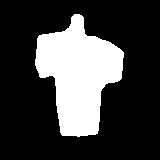

In [27]:

rgb,depth,final=model.predict(train_dataloader[0][0])

final=np.argmax(final,axis=-1)

final=final*255
cv2_imshow(np.reshape(final,(160,160)))


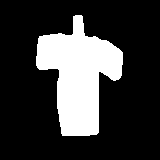

In [ ]:
cv2_imshow(np.argmax(train_dataset[0][2],axis=-1)*255)

E_score: 0.9664225587095023


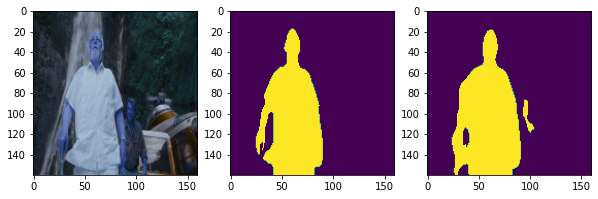

E_score: 0.9629805825656659


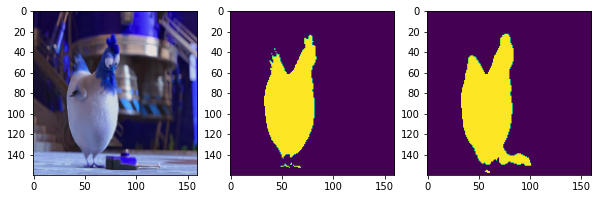

E_score: 0.9869902554347157


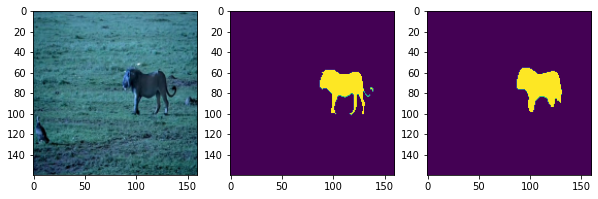

E_score: 0.9890844757693439


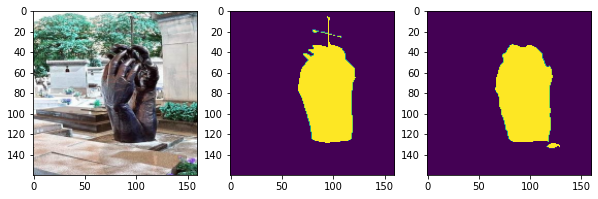

E_score: 0.9800990806414142


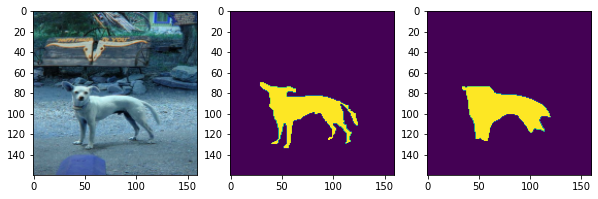

E_score: 0.9887422540253661


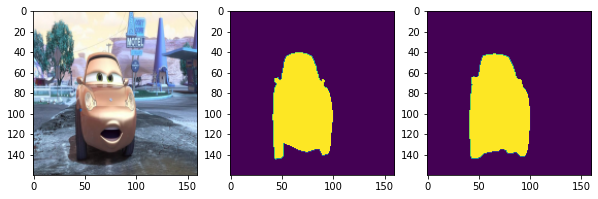

E_score: 0.9908159403360163


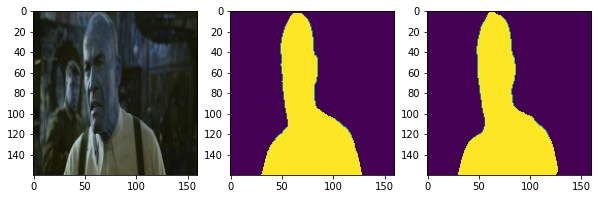

E_score: 0.8805531564731904


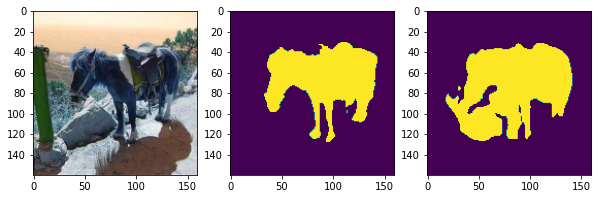

E_score: 0.8846923658898143


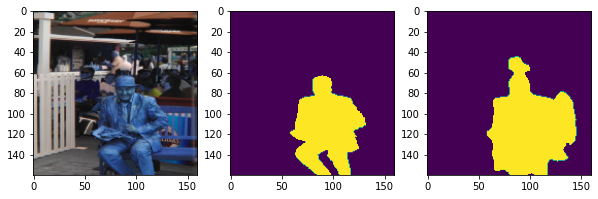

E_score: 0.9536650621493599


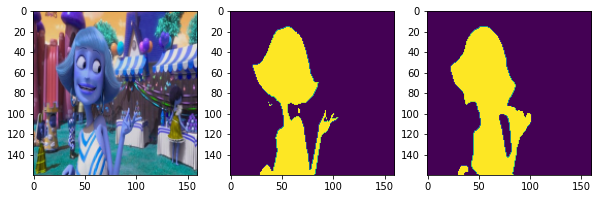

E_score: 0.7461287036835862


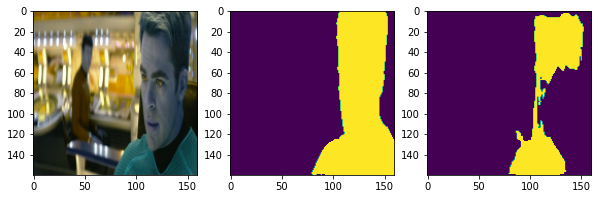

E_score: 0.9227566544070699


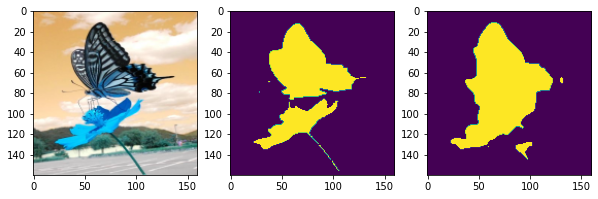

E_score: 0.7752769557435687


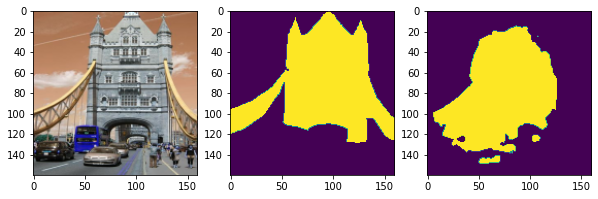

E_score: 0.8731328197644076


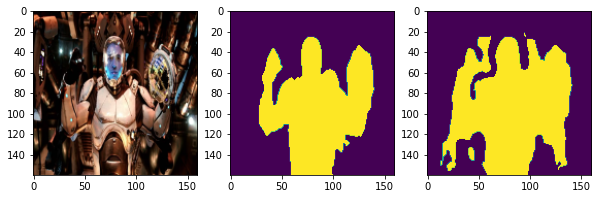

E_score: 0.9498498735585723


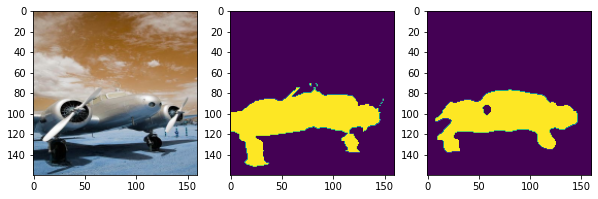

E_score: 0.9912331147975928


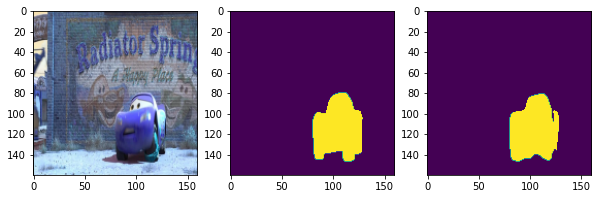

E_score: 0.988188456622459


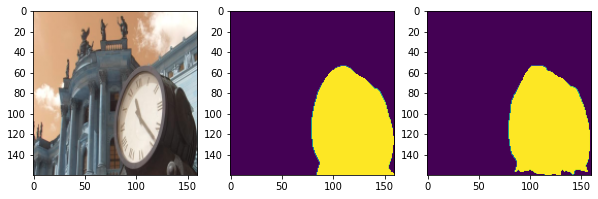

E_score: 0.9912698273267238


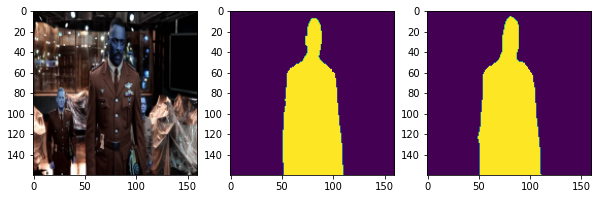

E_score: 0.9635906886920925


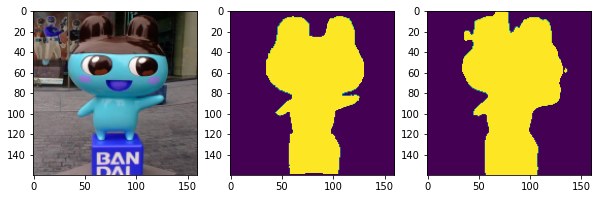

E_score: 0.9617087167652943


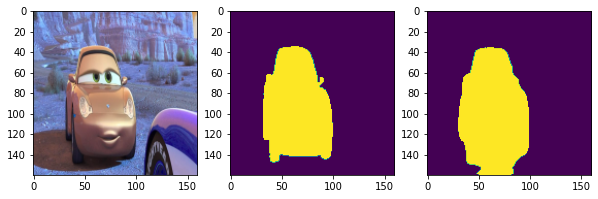

In [29]:



import matplotlib.pyplot as plt

for  i in range(20,40):                                             
    #original image
    gt_image = np.argmax(np.reshape(test_dataloader[i][1][2],(160,160,2)),axis=-1)*255

    #predicted saliency map                                                                                                                                                                                                        
    r,d,final = model.predict(test_dataloader[i][0])
    final=np.argmax(final,axis=-1)

    final=final*255

    plt.figure(figsize=(10,6))
    plt.subplot(131)
    plt.imshow(np.reshape(test_dataloader[i][0][0],(160,160,3)))
    plt.subplot(132)
    plt.imshow(gt_image)
    plt.subplot(133)
    plt.imshow(np.reshape(final,(160,160)))
    print('E_score:',E_score(np.reshape(gt_image,(1,160,160)),np.reshape(final,(1,160,160))))                                                            
    plt.show()